In [1]:
import  numpy as np 
import matplotlib.pyplot as plt 
from matplotlib.ticker import NullFormatter
import pandas as pd 
import seaborn as sns
from sklearn.preprocessing   import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from time import time

from mpl_toolkits.mplot3d import Axes3D



sns.set()
np.random.seed(0)

In [2]:
train_df = pd.read_csv ("Data/training.csv")
test_df  = pd.read_csv ("Data/test.csv")

In [3]:
train_df.head()

,EventId,DER_mass_MMC,DER_mass_transverse_met_lep,DER_mass_vis,DER_pt_h,DER_deltaeta_jet_jet,DER_mass_jet_jet,DER_prodeta_jet_jet,DER_deltar_tau_lep,DER_pt_tot,...,PRI_jet_num,PRI_jet_leading_pt,PRI_jet_leading_eta,PRI_jet_leading_phi,PRI_jet_subleading_pt,PRI_jet_subleading_eta,PRI_jet_subleading_phi,PRI_jet_all_pt,Weight,Label
0,100000,138.470,51.655,97.827,27.980,0.91,124.711,2.666,3.064,41.928,...,2,67.435,2.150,0.444,46.062,1.24,-2.475,113.497,0.002653,s
1,100001,160.937,68.768,103.235,48.146,-999.00,-999.000,-999.000,3.473,2.078,...,1,46.226,0.725,1.158,-999.000,-999.00,-999.000,46.226,2.233584,b
2,100002,-999.000,162.172,125.953,35.635,-999.00,-999.000,-999.000,3.148,9.336,...,1,44.251,2.053,-2.028,-999.000,-999.00,-999.000,44.251,2.347389,b
3,100003,143.905,81.417,80.943,0.414,-999.00,-999.000,-999.000,3.310,0.414,...,0,-999.000,-999.000,-999.000,-999.000,-999.00,-999.000,-0.000,5.446378,b
4,100004,175.864,16.915,134.805,16.405,-999.00,-999.000,-999.000,3.891,16.405,...,0,-999.000,-999.000,-999.000,-999.000,-999.00,-999.000,0.000,6.245333,b


In [6]:
len(train_df)

250000

# Analyzing the data

In [7]:
training_df = train_df.drop(['EventId' , 'Weight' ], axis = 1)  
training_df.replace( -999 , np.nan ,  inplace=True )

**Unbalanced Data ?**

In [8]:
Y = np.array ( train_df['Label'] )

In [9]:
print ( "% of the class Boson : " , round( np.sum ( Y == 's' ) / len(train_df) , 2 ) * 100  , " % ")
print ( "% of the class Background : " , round ( np.sum ( Y == 'b' ) / len(train_df) , 2  ) * 100 , " % " )

% of the class Boson :  34.0  % 
% of the class Background :  66.0  % 


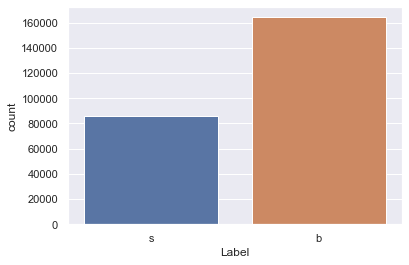

In [10]:
sns.countplot(training_df['Label']);

**Description**

In [11]:
training_df.describe()

,DER_mass_MMC,DER_mass_transverse_met_lep,DER_mass_vis,DER_pt_h,DER_deltaeta_jet_jet,DER_mass_jet_jet,DER_prodeta_jet_jet,DER_deltar_tau_lep,DER_pt_tot,DER_sum_pt,...,PRI_met_phi,PRI_met_sumet,PRI_jet_num,PRI_jet_leading_pt,PRI_jet_leading_eta,PRI_jet_leading_phi,PRI_jet_subleading_pt,PRI_jet_subleading_eta,PRI_jet_subleading_phi,PRI_jet_all_pt
count,211886.000000,250000.000000,250000.000000,250000.000000,72543.000000,72543.000000,72543.000000,250000.000000,250000.000000,250000.000000,...,250000.000000,250000.000000,250000.000000,150087.000000,150087.000000,150087.000000,72543.000000,72543.000000,72543.000000,250000.000000
mean,121.858528,49.239819,81.181982,57.895962,2.403735,371.783360,-0.821688,2.373100,18.917332,158.432217,...,-0.010119,209.797178,0.979176,84.822105,-0.003275,-0.012393,57.679474,-0.011845,-0.001582,73.064591
std,57.298157,35.344886,40.828691,63.655682,1.742226,397.699325,3.584362,0.782911,22.273494,115.706115,...,1.812223,126.499506,0.977426,60.662276,1.784546,1.813385,31.985782,2.031743,1.816950,98.015662
min,9.044000,0.000000,6.329000,0.000000,0.000000,13.602000,-18.066000,0.208000,0.000000,46.104000,...,-3.142000,13.678000,0.000000,30.000000,-4.499000,-3.142000,30.000000,-4.500000,-3.142000,0.000000
25%,91.885250,19.241000,59.388750,14.068750,0.882500,111.977000,-2.629000,1.810000,2.841000,77.550000,...,-1.575000,123.017500,0.000000,44.422500,-1.342000,-1.584000,37.312000,-1.612000,-1.576500,0.000000
50%,112.406000,46.524000,73.752000,38.467500,2.107000,225.885000,-0.244000,2.491500,12.315500,120.664500,...,-0.024000,179.739000,1.000000,65.561000,0.000000,-0.033000,47.902000,-0.010000,-0.002000,40.512500
75%,135.482000,73.598000,92.259000,79.169000,3.690000,478.226000,0.958000,2.961000,27.591000,200.478250,...,1.561000,263.379250,2.000000,103.342000,1.336000,1.562000,66.637000,1.589500,1.576000,109.933750
max,1192.026000,690.075000,1349.351000,2834.999000,8.503000,4974.979000,16.690000,5.684000,2834.999000,1852.462000,...,3.142000,2003.976000,3.000000,1120.573000,4.499000,3.141000,721.456000,4.500000,3.142000,1633.433000


**Missing Values**

In [12]:
# -1 to not iterate to the label column 
d = { col : round( ( len(training_df) - training_df[col].count() )  / len(training_df) , 2 )  for col in training_df.columns[:-1] }

d

{'DER_mass_MMC': 0.15,
 'DER_mass_transverse_met_lep': 0.0,
 'DER_mass_vis': 0.0,
 'DER_pt_h': 0.0,
 'DER_deltaeta_jet_jet': 0.71,
 'DER_mass_jet_jet': 0.71,
 'DER_prodeta_jet_jet': 0.71,
 'DER_deltar_tau_lep': 0.0,
 'DER_pt_tot': 0.0,
 'DER_sum_pt': 0.0,
 'DER_pt_ratio_lep_tau': 0.0,
 'DER_met_phi_centrality': 0.0,
 'DER_lep_eta_centrality': 0.71,
 'PRI_tau_pt': 0.0,
 'PRI_tau_eta': 0.0,
 'PRI_tau_phi': 0.0,
 'PRI_lep_pt': 0.0,
 'PRI_lep_eta': 0.0,
 'PRI_lep_phi': 0.0,
 'PRI_met': 0.0,
 'PRI_met_phi': 0.0,
 'PRI_met_sumet': 0.0,
 'PRI_jet_num': 0.0,
 'PRI_jet_leading_pt': 0.4,
 'PRI_jet_leading_eta': 0.4,
 'PRI_jet_leading_phi': 0.4,
 'PRI_jet_subleading_pt': 0.71,
 'PRI_jet_subleading_eta': 0.71,
 'PRI_jet_subleading_phi': 0.71,
 'PRI_jet_all_pt': 0.0}

In [13]:
d_missing  = { k : v for k,v in d.items() if v != 0 }
ms_df = pd.DataFrame.from_dict ( {'Missing values columns' : list(d_missing.keys()) , 
                          'Missing Rate' :    list(d_missing.values())} )

In [14]:
ms_df.sort_values('Missing Rate',ascending=False)

,Missing values columns,Missing Rate
1,DER_deltaeta_jet_jet,0.71
2,DER_mass_jet_jet,0.71
3,DER_prodeta_jet_jet,0.71
4,DER_lep_eta_centrality,0.71
8,PRI_jet_subleading_pt,0.71
9,PRI_jet_subleading_eta,0.71
10,PRI_jet_subleading_phi,0.71
5,PRI_jet_leading_pt,0.40
6,PRI_jet_leading_eta,0.40
7,PRI_jet_leading_phi,0.40


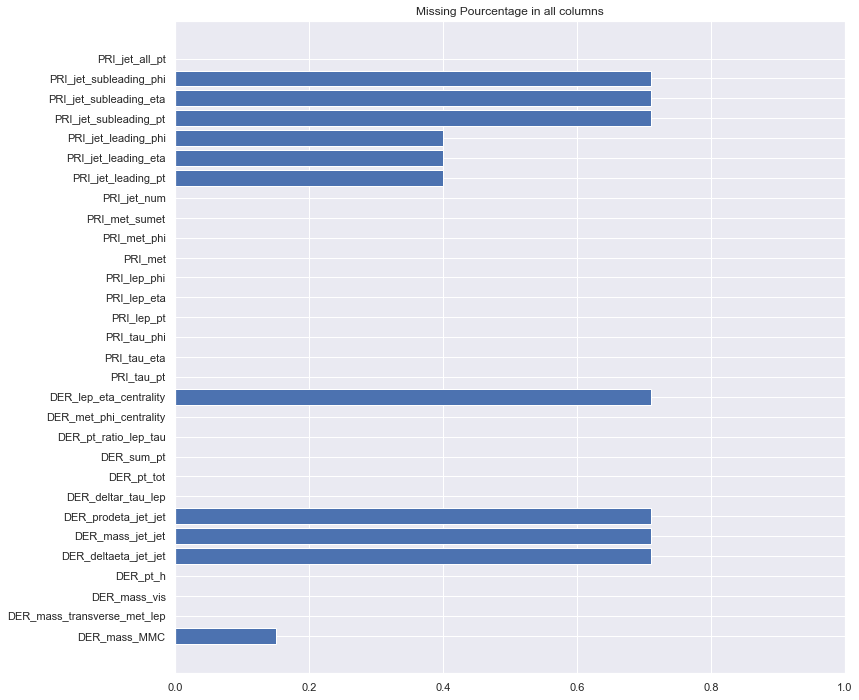

In [15]:
ls = list(d.values())

sns.set(color_codes=True)
plt.figure(figsize=(12,12))
plt.barh( np.arange(len(ls)) , ls )
plt.yticks( np.arange(len(ls))  , list(training_df.columns) )
plt.xlim (0,1)
plt.savefig('books_read.png')
plt.title("Missing Pourcentage in all columns")
plt.show()

In [16]:
Y = (Y == 's').astype(np.int8)

**Correlation**

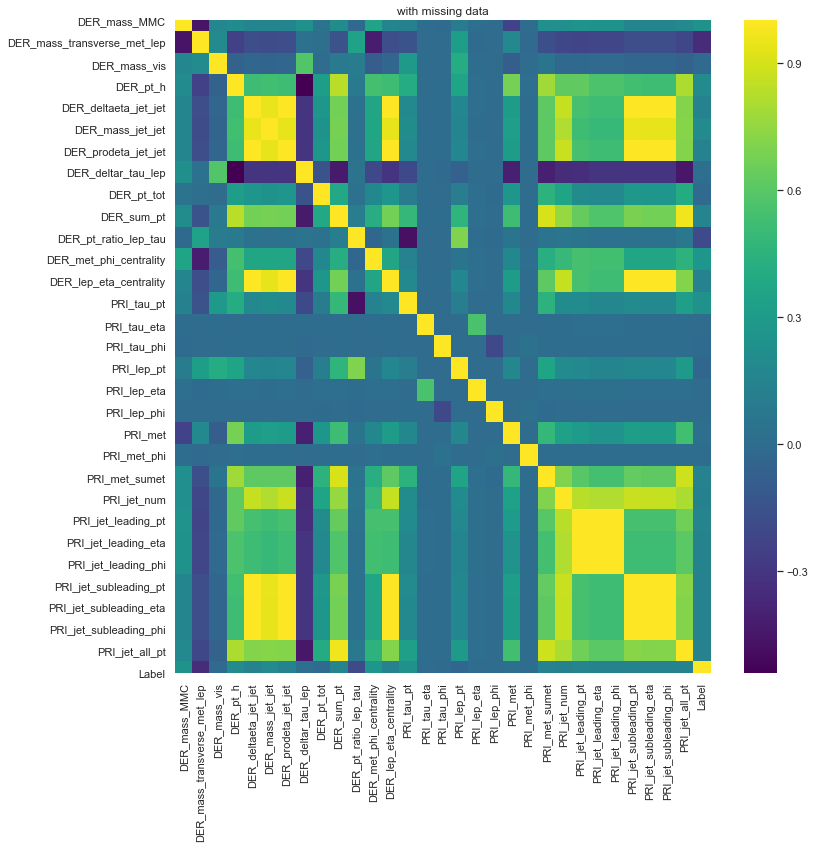

In [17]:
temp_df = train_df.drop( ['EventId','Weight'] , axis = 1 )
temp_df['Label'] = Y

plt.figure(figsize=(12,12))
plt.title('with missing data')
sns.heatmap(temp_df.corr(),cmap='viridis'  )

plt.show()

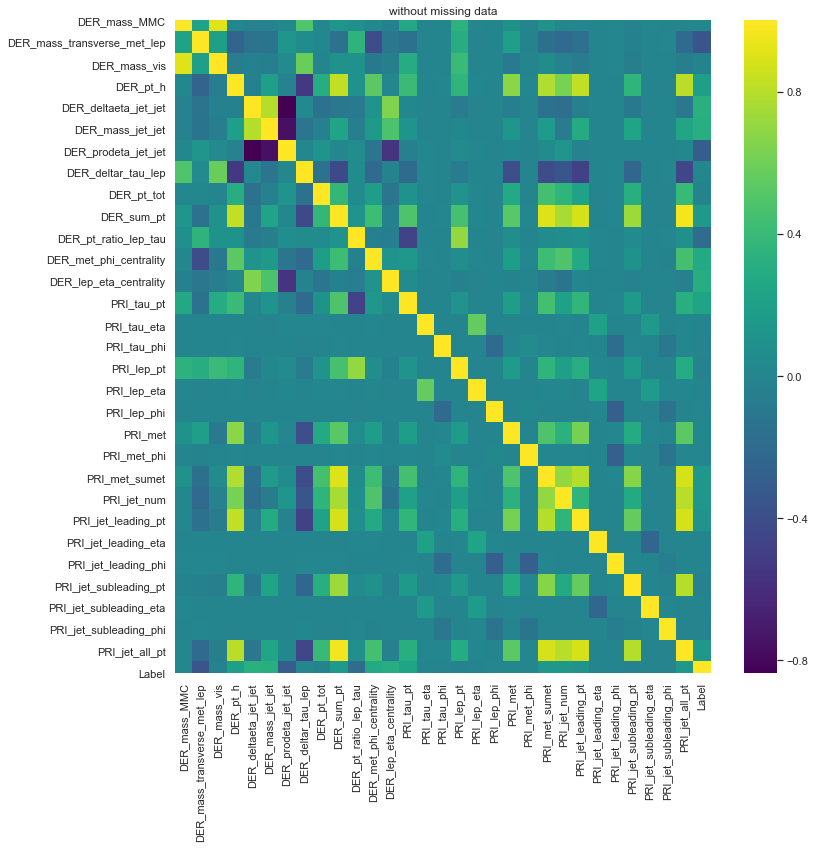

In [18]:
temp_df = training_df
temp_df['Label'] =  Y

plt.figure(figsize=(12,12))
plt.title('without missing data')
res = sns.heatmap(temp_df.corr(),cmap='viridis')

plt.show()

In [19]:
corr =  temp_df.corr()

In [20]:
a = pd.DataFrame ( corr['Label'].values , index = list(corr.index) )

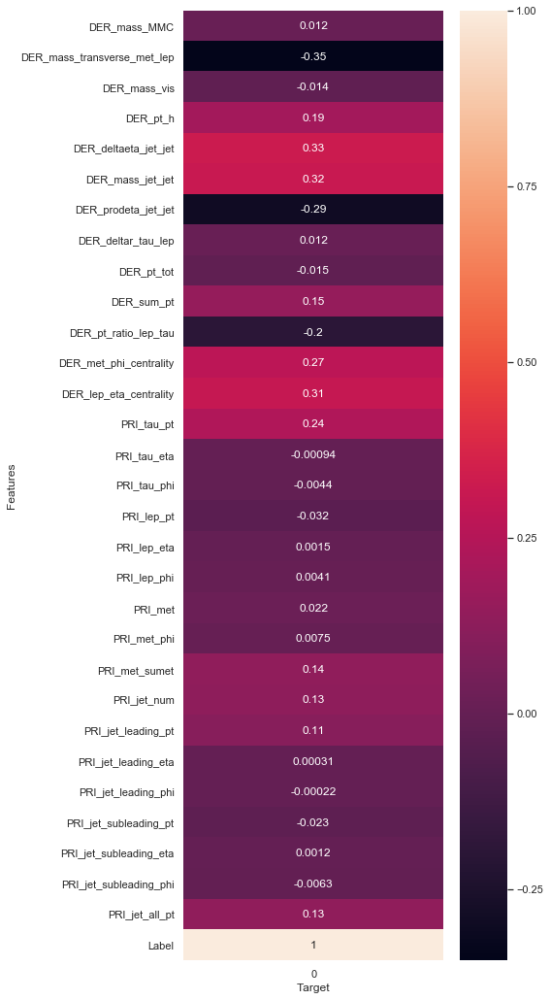

In [21]:
plt.figure(figsize=(6,18))
plt.tight_layout()
sns.heatmap( a , annot=True )
plt.ylim(31,0)
plt.ylabel("Features")
plt.xlabel("Target")

plt.show()

**Clean_Features**

In [22]:
features_missing = [ k for k,v in d.items() if v != 0 ] + ['Label']
no_missing_df = training_df [training_df.columns.difference(features_missing)]



no_missing_df.head()

,DER_deltar_tau_lep,DER_mass_transverse_met_lep,DER_mass_vis,DER_met_phi_centrality,DER_pt_h,DER_pt_ratio_lep_tau,DER_pt_tot,DER_sum_pt,PRI_jet_all_pt,PRI_jet_num,PRI_lep_eta,PRI_lep_phi,PRI_lep_pt,PRI_met,PRI_met_phi,PRI_met_sumet,PRI_tau_eta,PRI_tau_phi,PRI_tau_pt
0,3.064,51.655,97.827,1.396,27.980,1.582,41.928,197.760,113.497,2,2.273,-2.414,51.626,16.824,-0.277,258.733,1.017,0.381,32.638
1,3.473,68.768,103.235,1.414,48.146,0.879,2.078,125.157,46.226,1,0.501,0.103,36.918,44.704,-1.916,164.546,2.039,-3.011,42.014
2,3.148,162.172,125.953,1.414,35.635,3.776,9.336,197.814,44.251,1,-0.953,1.052,121.409,54.283,-2.186,260.414,-0.705,-2.093,32.154
3,3.310,81.417,80.943,-1.285,0.414,2.354,0.414,75.968,-0.000,0,-0.522,-3.100,53.321,31.082,0.060,86.062,-1.655,0.010,22.647
4,3.891,16.915,134.805,-1.385,16.405,1.056,16.405,57.983,0.000,0,0.798,1.569,29.774,2.723,-0.871,53.131,-2.197,-2.231,28.209


In [23]:
list(no_missing_df.columns)

['DER_deltar_tau_lep',
 'DER_mass_transverse_met_lep',
 'DER_mass_vis',
 'DER_met_phi_centrality',
 'DER_pt_h',
 'DER_pt_ratio_lep_tau',
 'DER_pt_tot',
 'DER_sum_pt',
 'PRI_jet_all_pt',
 'PRI_jet_num',
 'PRI_lep_eta',
 'PRI_lep_phi',
 'PRI_lep_pt',
 'PRI_met',
 'PRI_met_phi',
 'PRI_met_sumet',
 'PRI_tau_eta',
 'PRI_tau_phi',
 'PRI_tau_pt']

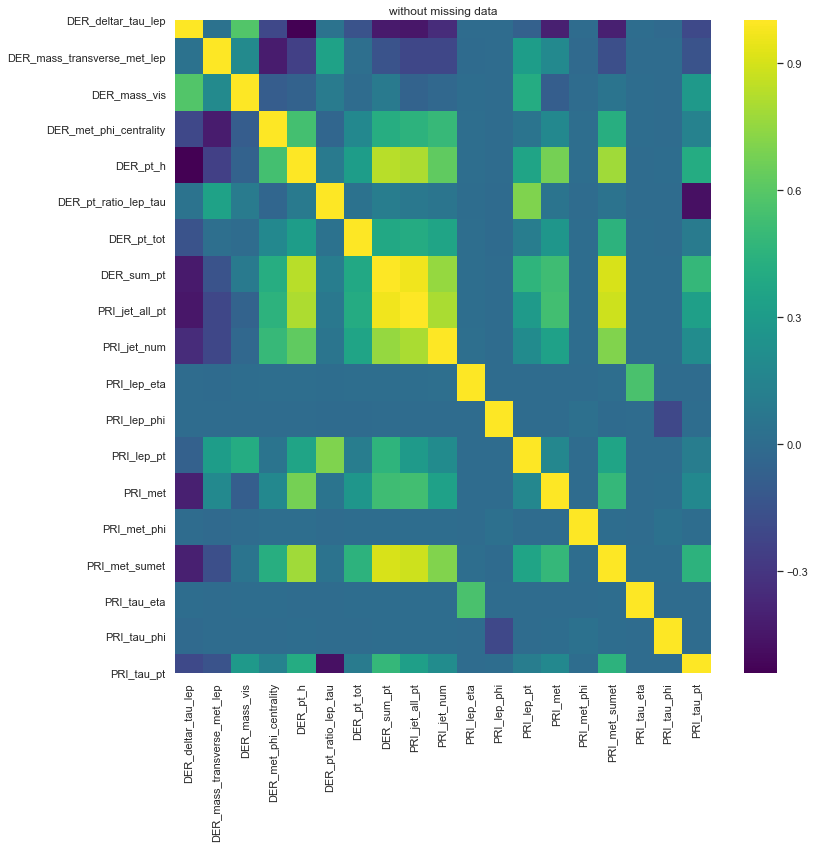

In [24]:
plt.figure(figsize=(12,12))
plt.title('without missing data')
res = sns.heatmap(no_missing_df.corr(),cmap='viridis')

plt.show()

### Features Distributions impact on classes

In [40]:
training_df = train_df.drop(['EventId' , 'Weight' ], axis = 1)  

X = ( training_df.values[:,:-1] )

In [41]:
X = X.astype(np.float64)
X

array([[ 138.47 ,   51.655,   97.827, ...,    1.24 ,   -2.475,  113.497],
       [ 160.937,   68.768,  103.235, ..., -999.   , -999.   ,   46.226],
       [-999.   ,  162.172,  125.953, ..., -999.   , -999.   ,   44.251],
       ...,
       [ 105.457,   60.526,   75.839, ..., -999.   , -999.   ,   41.992],
       [  94.951,   19.362,   68.812, ..., -999.   , -999.   ,    0.   ],
       [-999.   ,   72.756,   70.831, ..., -999.   , -999.   ,    0.   ]])

In [30]:
np.log ( X[Y==1,0] + np.abs( X[Y==1,0] )+1  ) 

array([5.62740526, 5.69879673, 5.73925257, ..., 5.59066603, 5.56509495,
       5.35618053])

In [31]:
training_df.head()

,DER_mass_MMC,DER_mass_transverse_met_lep,DER_mass_vis,DER_pt_h,DER_deltaeta_jet_jet,DER_mass_jet_jet,DER_prodeta_jet_jet,DER_deltar_tau_lep,DER_pt_tot,DER_sum_pt,...,PRI_met_sumet,PRI_jet_num,PRI_jet_leading_pt,PRI_jet_leading_eta,PRI_jet_leading_phi,PRI_jet_subleading_pt,PRI_jet_subleading_eta,PRI_jet_subleading_phi,PRI_jet_all_pt,Label
0,138.470,51.655,97.827,27.980,0.91,124.711,2.666,3.064,41.928,197.760,...,258.733,2,67.435,2.150,0.444,46.062,1.24,-2.475,113.497,s
1,160.937,68.768,103.235,48.146,-999.00,-999.000,-999.000,3.473,2.078,125.157,...,164.546,1,46.226,0.725,1.158,-999.000,-999.00,-999.000,46.226,b
2,-999.000,162.172,125.953,35.635,-999.00,-999.000,-999.000,3.148,9.336,197.814,...,260.414,1,44.251,2.053,-2.028,-999.000,-999.00,-999.000,44.251,b
3,143.905,81.417,80.943,0.414,-999.00,-999.000,-999.000,3.310,0.414,75.968,...,86.062,0,-999.000,-999.000,-999.000,-999.000,-999.00,-999.000,-0.000,b
4,175.864,16.915,134.805,16.405,-999.00,-999.000,-999.000,3.891,16.405,57.983,...,53.131,0,-999.000,-999.000,-999.000,-999.000,-999.00,-999.000,0.000,b


**DER_mass_MMC (15% missing)**

In [36]:
10 ** 6 

1000000

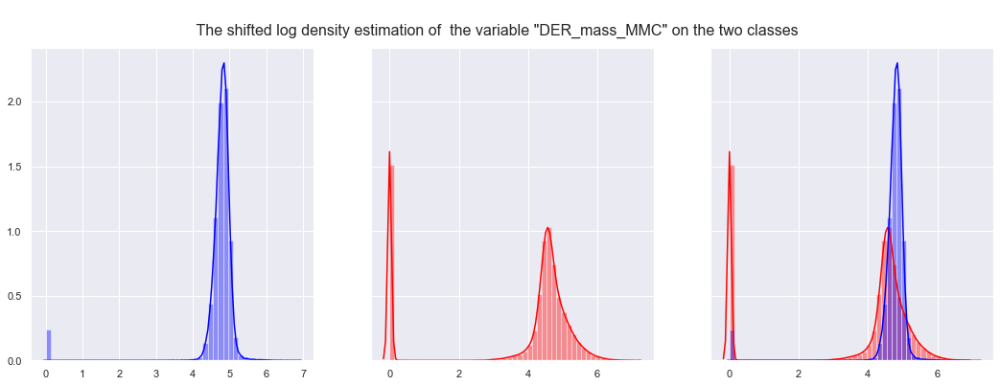

In [26]:
X = np.nan_to_num ( training_df.values[:,:-1] , -99 ) 

i = 0

poww = 6 

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The shifted log density estimation of  the variable "'+training_df.columns[i]+'" on the two classes ' , fontsize=16)
sns.distplot(np.log ( X[Y==1,i] + np.abs (X[Y==1,i].min()) + 1 ) , ax=axes[0] , color='blue'   );
sns.distplot(np.log ( X[Y==0,i] + np.abs (X[Y==0,i].min()) + 1 ), ax=axes[1] , color ='red'   );
sns.distplot(np.log ( X[Y==0,i] + np.abs (X[Y==0,i].min()) + 1 ), ax=axes[2] , color='red'   );
sns.distplot(np.log ( X[Y==1,i] + np.abs (X[Y==1,i].min()) + 1 ), ax=axes[2] , color='blue'  );

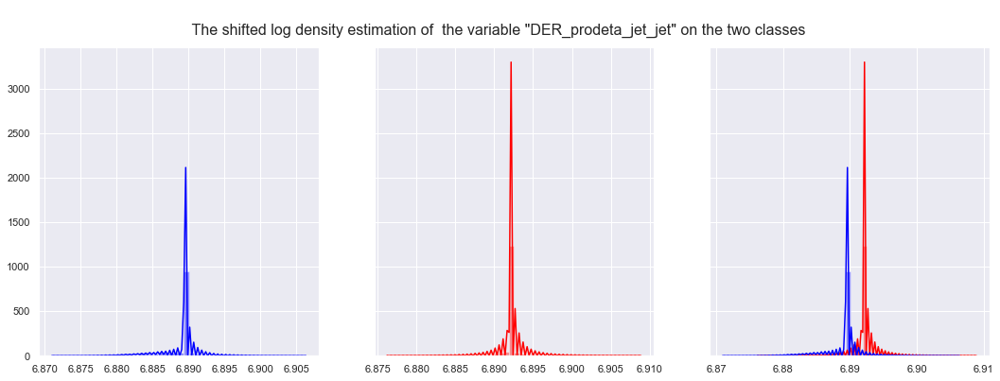

In [27]:
i = 6

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The shifted log density estimation of  the variable "'+training_df.columns[i]+'" on the two classes ' , fontsize=16)
sns.distplot(np.log ( X[Y==1,i] + X[Y==1,i].min() + 1000 ) , ax=axes[0] , color='blue'   );
sns.distplot(np.log ( X[Y==0,i] + X[Y==0,i].min() + 1000 ), ax=axes[1] , color ='red'   );
sns.distplot(np.log ( X[Y==0,i] + X[Y==0,i].min() + 1000 ), ax=axes[2] , color='red'   );
sns.distplot(np.log ( X[Y==1,i] + X[Y==1,i].min() + 1000 ), ax=axes[2] , color='blue'  );

In [28]:
X = no_missing_df.values

X

array([[  3.064,  51.655,  97.827, ...,   1.017,   0.381,  32.638],
       [  3.473,  68.768, 103.235, ...,   2.039,  -3.011,  42.014],
       [  3.148, 162.172, 125.953, ...,  -0.705,  -2.093,  32.154],
       ...,
       [  2.39 ,  60.526,  75.839, ...,  -0.266,  -3.132,  35.636],
       [  3.365,  19.362,  68.812, ...,  -2.211,   2.792,  27.944],
       [  2.025,  72.756,  70.831, ...,   1.685,   2.653,  43.003]])

**DER_deltar_tau_lep**

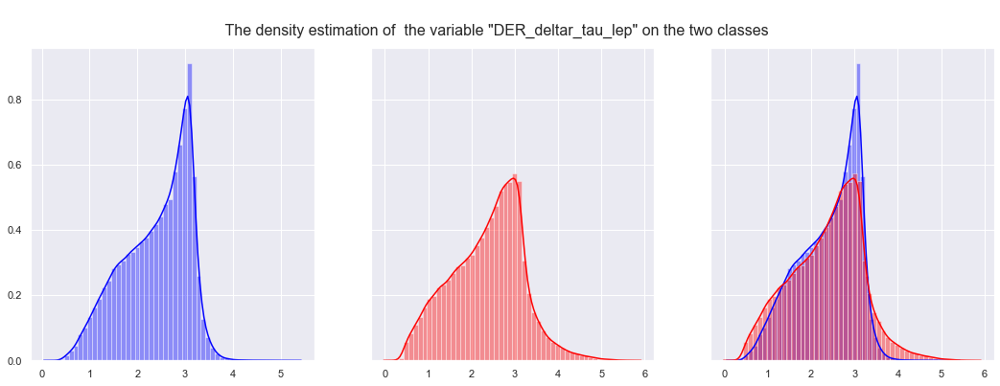

In [29]:
i = 0

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)
sns.distplot(X[Y==1,i] , ax=axes[0] , color='blue'   );
sns.distplot(X[Y==0,i] , ax=axes[1] , color ='red'   );
sns.distplot(X[Y==1,i] , ax=axes[2] , color='blue'  );
sns.distplot(X[Y==0,i] , ax=axes[2] , color='red'   );



**DER_mass_transverse_met_lep**

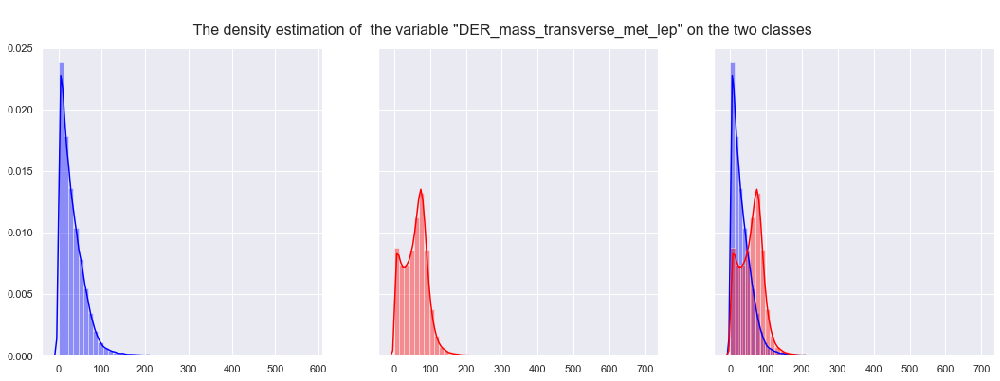

In [25]:
i = 1

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)
sns.distplot(X[Y==1,i] , ax=axes[0] , color='blue'   );
sns.distplot(X[Y==0,i] , ax=axes[1] , color ='red'   );
sns.distplot(X[Y==1,i] , ax=axes[2] , color='blue'  );
sns.distplot(X[Y==0,i] , ax=axes[2] , color='red'   );



**DER_mass_vis**

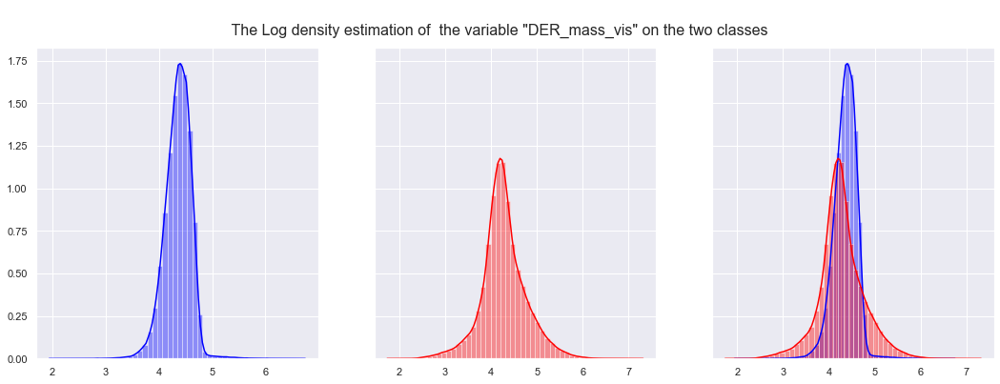

In [26]:
i = 2

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The Log density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)
sns.distplot(np.log ( X[Y==1,i] ) , ax=axes[0] , color='blue'   );
sns.distplot(np.log ( X[Y==0,i] ) , ax=axes[1] , color ='red'   );
sns.distplot(np.log ( X[Y==1,i] ) , ax=axes[2] , color='blue'  );
sns.distplot(np.log ( X[Y==0,i] ) , ax=axes[2] , color='red'   );



**DER_met_phi_centrality**

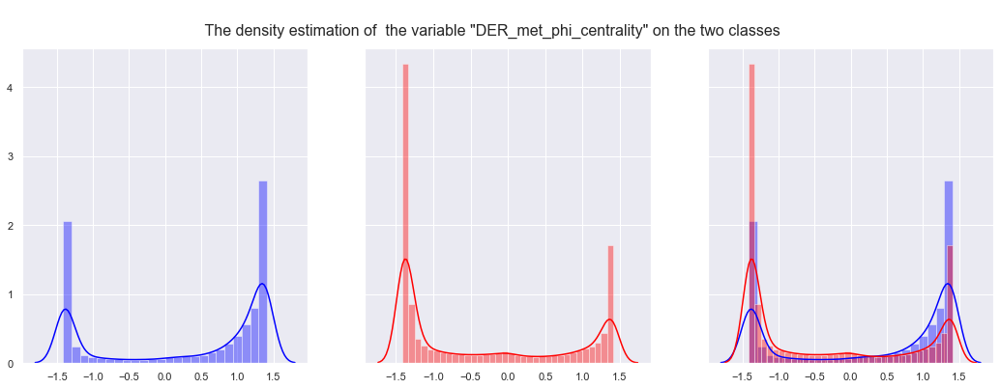

In [27]:
i = 3

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)
sns.distplot(X[Y==1,i] , ax=axes[0] , color='blue'   );
sns.distplot(X[Y==0,i] , ax=axes[1] , color ='red'   );
sns.distplot(X[Y==1,i] , ax=axes[2] , color='blue'  );
sns.distplot(X[Y==0,i] , ax=axes[2] , color='red'   );



**DER_pt_h**

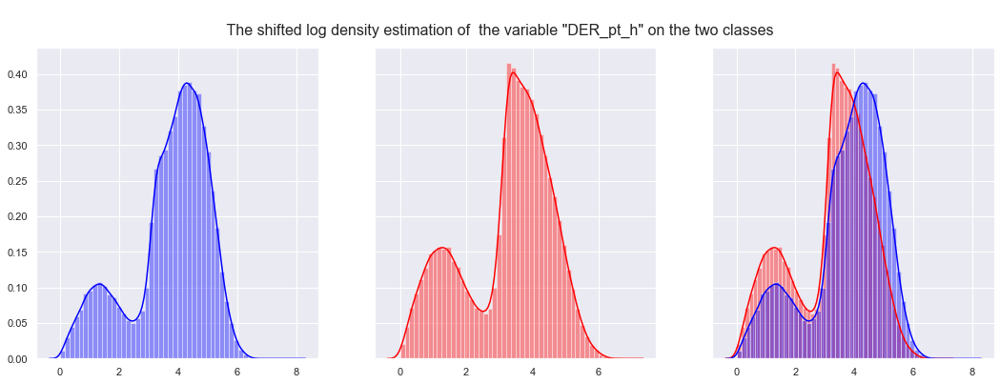

In [28]:
i = 4

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The shifted log density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)
sns.distplot(np.log ( X[Y==1,i] + X[Y==1,i].min() + 1 ) , ax=axes[0] , color='blue'   );
sns.distplot(np.log ( X[Y==0,i] + X[Y==0,i].min() + 1 ), ax=axes[1] , color ='red'   );
sns.distplot(np.log ( X[Y==0,i] + X[Y==0,i].min() + 1 ), ax=axes[2] , color='red'   );
sns.distplot(np.log ( X[Y==1,i] + X[Y==1,i].min() + 1 ), ax=axes[2] , color='blue'  );



**DER_pt_ratio_lep_tau**

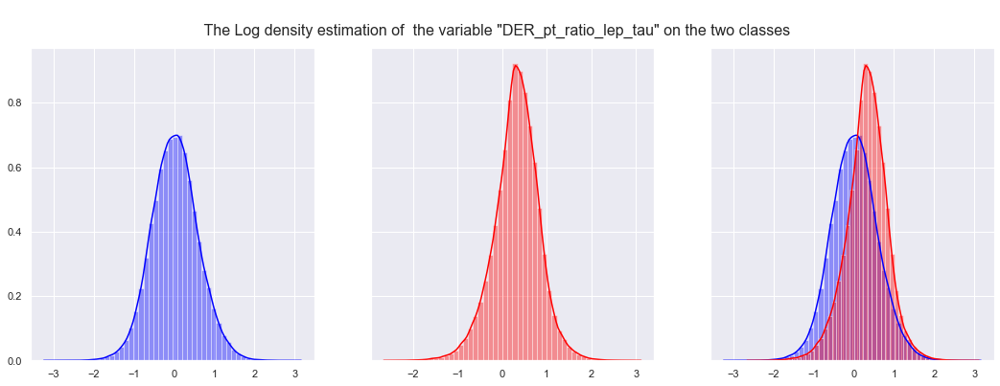

In [29]:
i = 5

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The Log density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)
sns.distplot(np.log(X[Y==1,i]) , ax=axes[0] , color='blue'   );
sns.distplot(np.log(X[Y==0,i]), ax=axes[1] , color ='red'   );
sns.distplot(np.log(X[Y==1,i]) , ax=axes[2] , color='blue'  );
sns.distplot(np.log(X[Y==0,i]) , ax=axes[2] , color='red'   );



**DER_pt_tot**

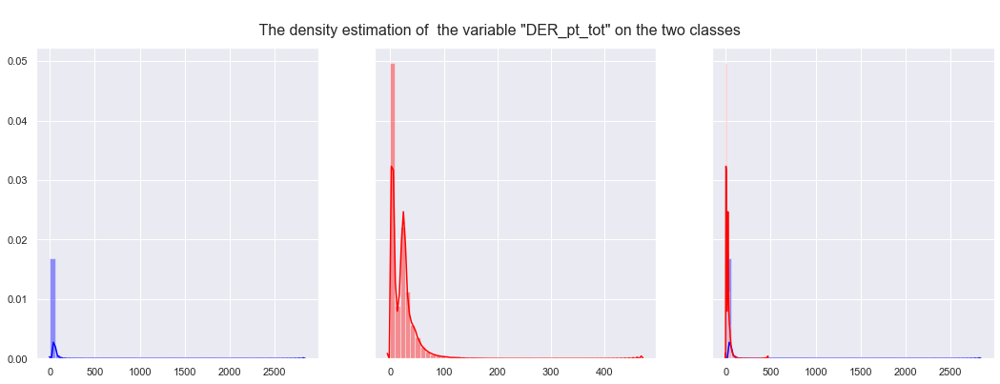

In [30]:
i = 6

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)
sns.distplot(X[Y==1,i] , ax=axes[0] , color='blue'   );
sns.distplot(X[Y==0,i] , ax=axes[1] , color ='red'   );
sns.distplot(X[Y==1,i] , ax=axes[2] , color='blue'  );
sns.distplot(X[Y==0,i] , ax=axes[2] , color='red'   );



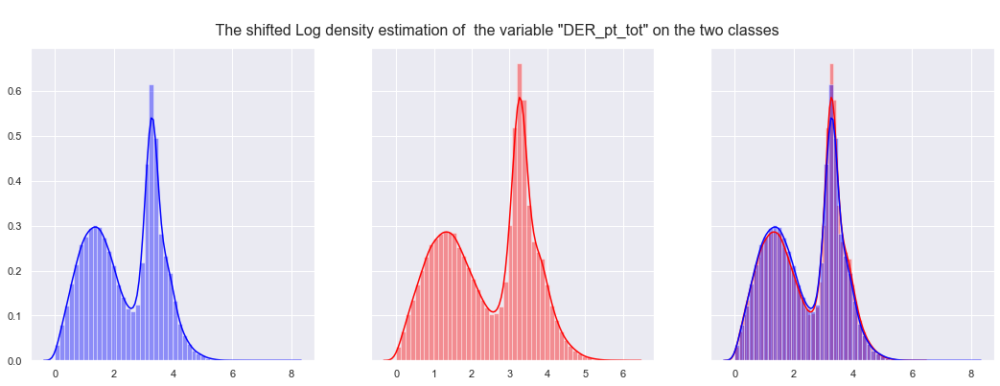

In [31]:
i = 6

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The shifted Log density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)
sns.distplot(np.log ( X[Y==1,i] + X[Y==1,i].min() + 1 ) , ax=axes[0] , color='blue'   );
sns.distplot(np.log ( X[Y==0,i] + X[Y==0,i].min() + 1 ), ax=axes[1] , color ='red'   );
sns.distplot(np.log ( X[Y==0,i] + X[Y==0,i].min() + 1 ), ax=axes[2] , color='red'   );
sns.distplot(np.log ( X[Y==1,i] + X[Y==1,i].min() + 1 ), ax=axes[2] , color='blue'  );



**DER_sum_pt**

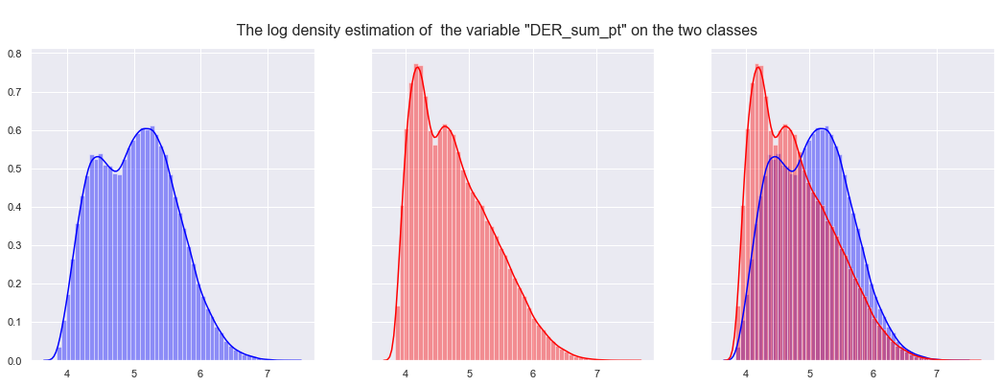

In [32]:
i = 7

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The log density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)

sns.distplot(np.log(X[Y==1,i]) , ax=axes[0] , color='blue'   );
sns.distplot(np.log(X[Y==0,i]), ax=axes[1] , color ='red'   );
sns.distplot(np.log(X[Y==1,i]) , ax=axes[2] , color='blue'  );
sns.distplot(np.log(X[Y==0,i]) , ax=axes[2] , color='red'   );

**PRI_jet_all_pt**

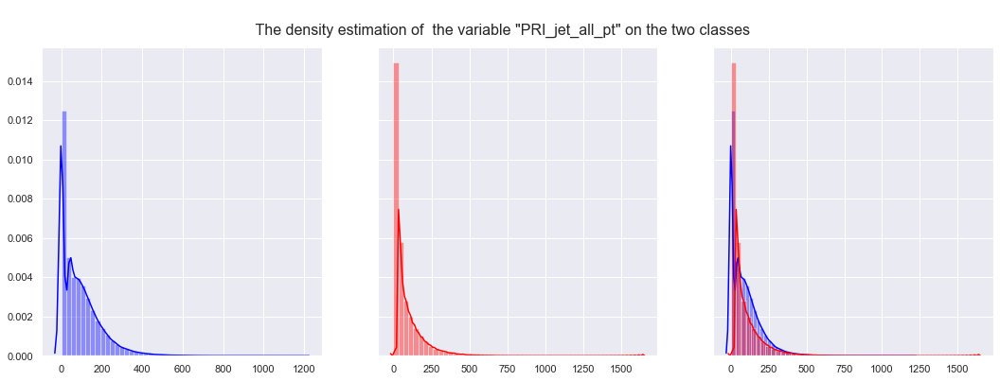

In [33]:
i = 8

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)
sns.distplot(X[Y==1,i] , ax=axes[0] , color='blue'   );
sns.distplot(X[Y==0,i] , ax=axes[1] , color ='red'   );
sns.distplot(X[Y==1,i] , ax=axes[2] , color='blue'  );
sns.distplot(X[Y==0,i] , ax=axes[2] , color='red'   );

**PRI_jet_num**

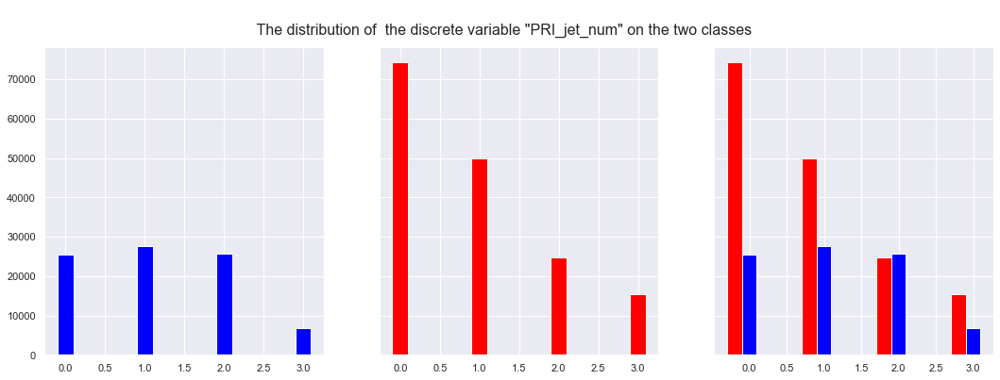

In [34]:
i = 9

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The distribution of  the discrete variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)

arr = np.unique( X[:,i] ).astype(np.int16)

axes[0].bar(arr     , np.bincount ( X[Y==1,9].astype(np.int16) )  , width=0.2 , color='blue' , align='center' );
axes[1].bar(arr , np.bincount ( X[Y==0,i].astype(np.int16) )  , width=0.2 ,  color='red' , align='center' );
axes[2].bar(arr-0.2 , np.bincount ( X[Y==0,i].astype(np.int16) )  , width=0.2 ,  color='red' , align='center' );
axes[2].bar(arr     , np.bincount ( X[Y==1,9].astype(np.int16) )  , width=0.2 , color='blue' , align='center' );



**PRI_lep_eta**

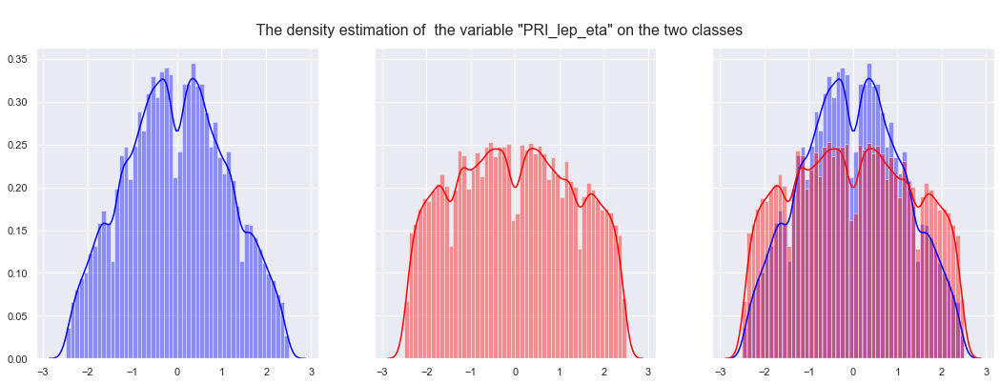

In [35]:
i = 10

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)

sns.distplot(X[Y==1,i] , ax=axes[0] , color='blue'   );
sns.distplot(X[Y==0,i] , ax=axes[1] , color ='red'   );
sns.distplot(X[Y==1,i] , ax=axes[2] , color='blue'  );
sns.distplot(X[Y==0,i] , ax=axes[2] , color='red'   );

**PRI_lep_phi**

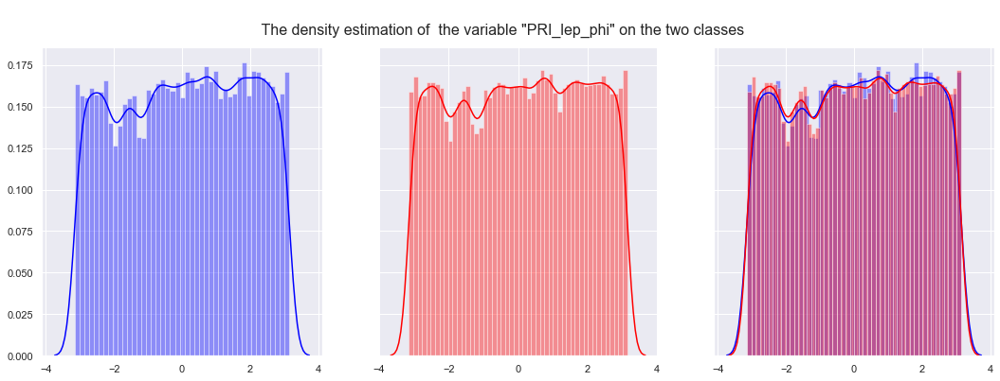

In [36]:
i = 11

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)

sns.distplot(X[Y==1,i] , ax=axes[0] , color='blue'   );
sns.distplot(X[Y==0,i] , ax=axes[1] , color ='red'   );
sns.distplot(X[Y==1,i] , ax=axes[2] , color='blue'  );
sns.distplot(X[Y==0,i] , ax=axes[2] , color='red'   );

**PRI_lep_pt**

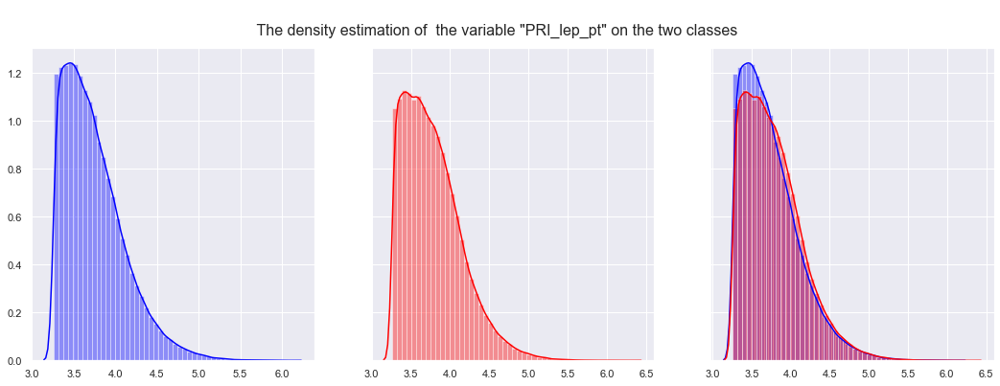

In [37]:
i = 12

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)

sns.distplot(np.log(X[Y==1,i]) , ax=axes[0] , color='blue'   );
sns.distplot(np.log(X[Y==0,i]), ax=axes[1] , color ='red'   );
sns.distplot(np.log(X[Y==1,i]) , ax=axes[2] , color='blue'  );
sns.distplot(np.log(X[Y==0,i]) , ax=axes[2] , color='red'   );

**PRI_met**

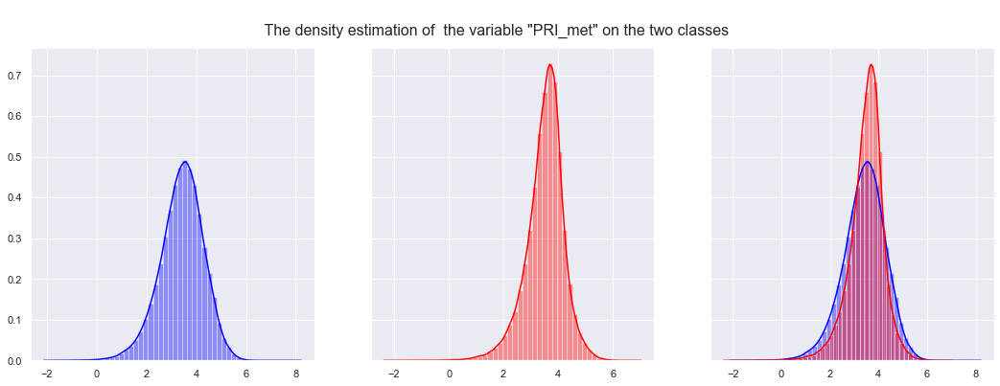

In [38]:
i = 13

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)

sns.distplot(np.log(X[Y==1,i]) , ax=axes[0] , color='blue'   );
sns.distplot(np.log(X[Y==0,i]), ax=axes[1] , color ='red'   );
sns.distplot(np.log(X[Y==1,i]) , ax=axes[2] , color='blue'  );
sns.distplot(np.log(X[Y==0,i]) , ax=axes[2] , color='red'   );

**PRI_met_phi**

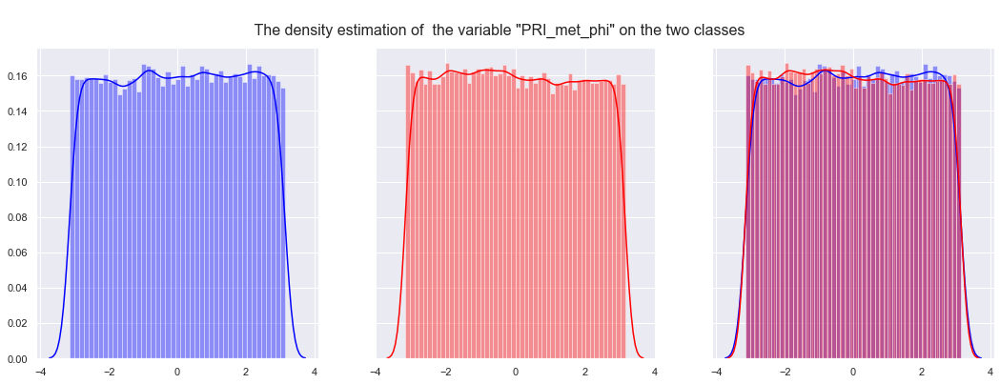

In [39]:
i = 14

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)

sns.distplot(X[Y==1,i] , ax=axes[0] , color='blue'   );
sns.distplot(X[Y==0,i] , ax=axes[1] , color ='red'   );
sns.distplot(X[Y==1,i] , ax=axes[2] , color='blue'  );
sns.distplot(X[Y==0,i] , ax=axes[2] , color='red'   );

**PRI_met_sumet**

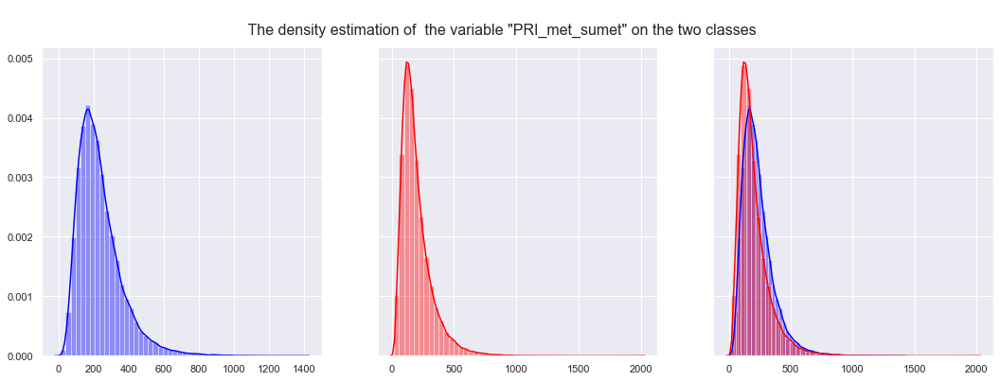

In [40]:
i = 15

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)

sns.distplot(X[Y==1,i] , ax=axes[0] , color='blue'   );
sns.distplot(X[Y==0,i] , ax=axes[1] , color ='red'   );
sns.distplot(X[Y==1,i] , ax=axes[2] , color='blue'  );
sns.distplot(X[Y==0,i] , ax=axes[2] , color='red'   );

**PRI_tau_eta**

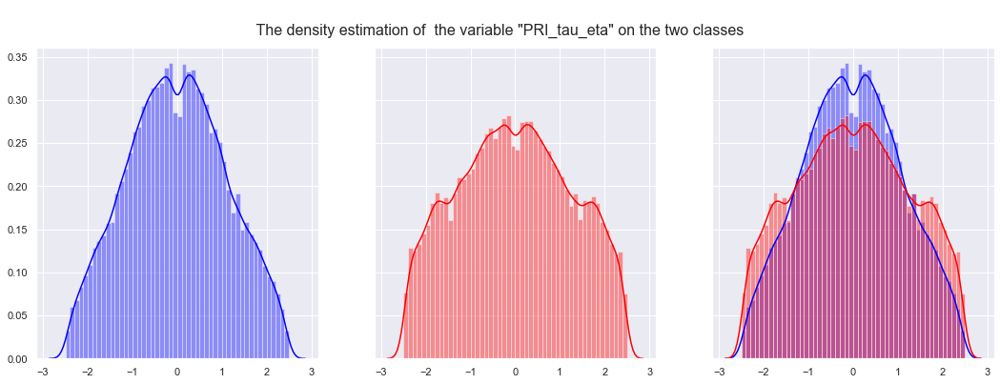

In [41]:
i = 16

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)

sns.distplot(X[Y==1,i] , ax=axes[0] , color='blue'   );
sns.distplot(X[Y==0,i] , ax=axes[1] , color ='red'   );
sns.distplot(X[Y==1,i] , ax=axes[2] , color='blue'  );
sns.distplot(X[Y==0,i] , ax=axes[2] , color='red'   );

**PRI_tau_phi**

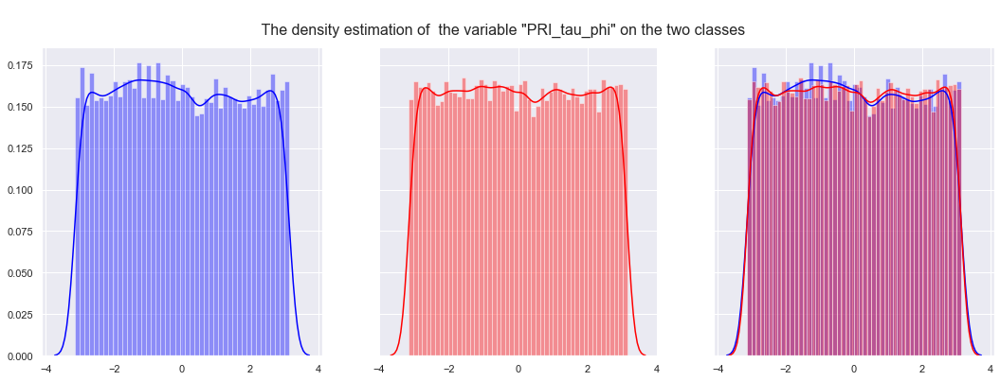

In [42]:
i = 17

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)

sns.distplot(X[Y==1,i] , ax=axes[0] , color='blue'   );
sns.distplot(X[Y==0,i] , ax=axes[1] , color ='red'   );
sns.distplot(X[Y==1,i] , ax=axes[2] , color='blue'  );
sns.distplot(X[Y==0,i] , ax=axes[2] , color='red'   );

**PRI_tau_pt**

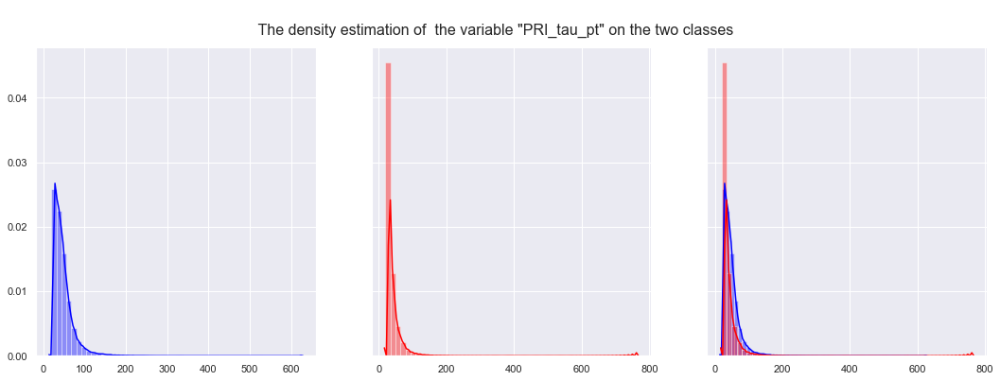

In [43]:
i = 18

fig, axes =plt.subplots(1,3, figsize = (18,6) , sharey = True )
fig.suptitle('\n The density estimation of  the variable "'+no_missing_df.columns[i]+'" on the two classes ' , fontsize=16)

sns.distplot(X[Y==1,i] , ax=axes[0] , color='blue'   );
sns.distplot(X[Y==0,i] , ax=axes[1] , color ='red'   );
sns.distplot(X[Y==1,i] , ax=axes[2] , color='blue'  );
sns.distplot(X[Y==0,i] , ax=axes[2] , color='red'   );

**Further More ...**

In [44]:
{ temp_df.columns[i]:i for i in range (len(temp_df.columns)) }

{'DER_mass_MMC': 0,
 'DER_mass_transverse_met_lep': 1,
 'DER_mass_vis': 2,
 'DER_pt_h': 3,
 'DER_deltaeta_jet_jet': 4,
 'DER_mass_jet_jet': 5,
 'DER_prodeta_jet_jet': 6,
 'DER_deltar_tau_lep': 7,
 'DER_pt_tot': 8,
 'DER_sum_pt': 9,
 'DER_pt_ratio_lep_tau': 10,
 'DER_met_phi_centrality': 11,
 'DER_lep_eta_centrality': 12,
 'PRI_tau_pt': 13,
 'PRI_tau_eta': 14,
 'PRI_tau_phi': 15,
 'PRI_lep_pt': 16,
 'PRI_lep_eta': 17,
 'PRI_lep_phi': 18,
 'PRI_met': 19,
 'PRI_met_phi': 20,
 'PRI_met_sumet': 21,
 'PRI_jet_num': 22,
 'PRI_jet_leading_pt': 23,
 'PRI_jet_leading_eta': 24,
 'PRI_jet_leading_phi': 25,
 'PRI_jet_subleading_pt': 26,
 'PRI_jet_subleading_eta': 27,
 'PRI_jet_subleading_phi': 28,
 'PRI_jet_all_pt': 29,
 'Label': 30}

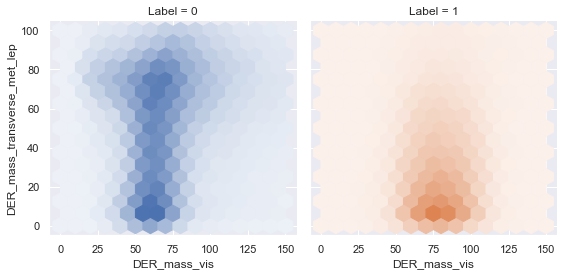

In [45]:
def hexbin(x, y, color, **kwargs):
    cmap = sns.light_palette(color, as_cmap=True)
    plt.hexbin(x, y, gridsize=15, cmap=cmap, **kwargs)

g = sns.FacetGrid( training_df , hue="Label", col="Label", height=4)   
g.map(hexbin, "DER_mass_vis", "DER_mass_transverse_met_lep", extent=[0, 150, 0, 100]);

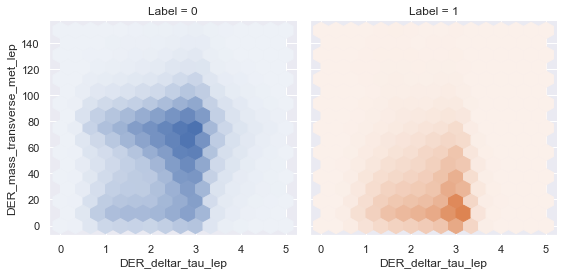

In [46]:
g = sns.FacetGrid( training_df , hue="Label", col="Label", height=4)   
g.map(hexbin, no_missing_df.columns[0] , no_missing_df.columns[1] , extent=[0, 5, 0, 150] );

In [47]:
from sklearn.manifold import Isomap



To try

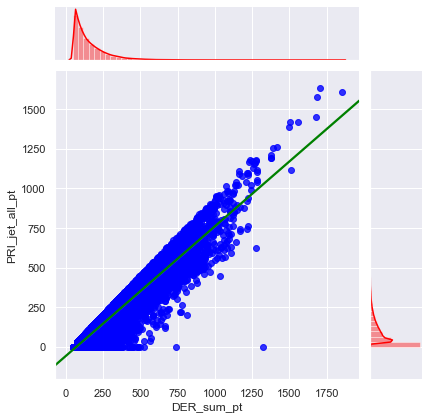

In [48]:
g = sns.jointplot( no_missing_df.columns[7] , no_missing_df.columns[8] , data= no_missing_df , kind="reg" ,  marginal_kws={'color': 'red'} , joint_kws={'color':'blue','line_kws':{'color':'green'}} )

plt.show()

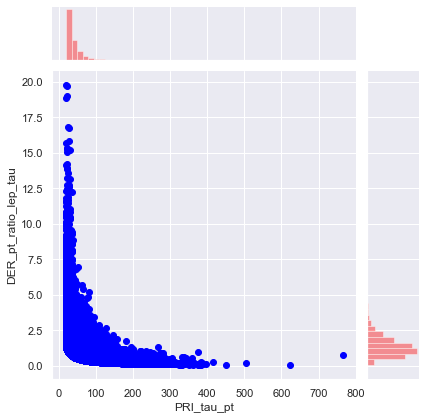

In [49]:
g = sns.jointplot( temp_df.columns[13] , temp_df.columns[10] , data= temp_df  ,  marginal_kws={'color': 'red'} , joint_kws={'color':'blue'} )

plt.show()

**PCA** 

In [65]:
X = no_missing_df.values

X.shape

(250000, 19)

In [87]:

# intialize pca and logistic regression model
pca = PCA(n_components=3)

# normalize
standarizer = StandardScaler()
X_std = standarizer.fit_transform(X)

# fit and transform data
X_pca = pca.fit_transform(X_std)

X_pca.shape

(250000, 3)

<IPython.core.display.Javascript object>


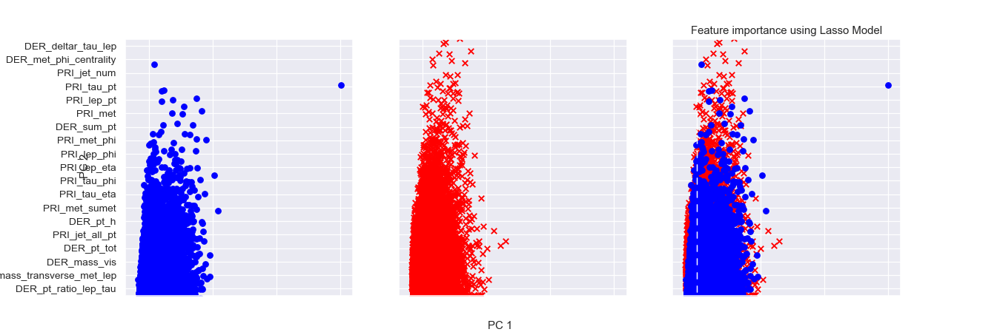

In [69]:
fig , ax = plt.subplots( nrows=1 , ncols=3 , sharey=True , sharex = True , figsize=(15,5) )

ax[0].scatter(X_pca[Y==1, 0] , X_pca[Y==1, 1] , c='blue' , label='s' , marker='o') 
ax[0].xaxis.set_major_formatter(NullFormatter())
ax[0].yaxis.set_major_formatter(NullFormatter())
ax[0].axis('tight')


ax[1].scatter(X_pca[Y==0, 0] , X_pca[Y==0,1] , c='red' , label='b' , marker='x') 
ax[1].xaxis.set_major_formatter(NullFormatter())
ax[1].yaxis.set_major_formatter(NullFormatter())
ax[1].axis('tight')


colors =  ['red', 'blue' ]
markers = [ 'x', 'o']
for l, c, m in zip(np.unique(Y), colors, markers):
    ax[2].scatter(X_pca[Y==l, 0] , X_pca[Y==l, 1] , c=c , label=l , marker=m )

ax[2].xaxis.set_major_formatter(NullFormatter())
ax[2].yaxis.set_major_formatter(NullFormatter())
ax[2].axis('tight')
    


fig.text(0.5, 0.01, 'PC 1', ha='center')
fig.text(0.08, 0.5, 'PC 2', va='center', rotation='vertical')


plt.show()

In [57]:
import plotly.express as px
iris = px.data.iris()
fig = px.scatter_3d(iris, x='sepal_length', y='sepal_width', z='petal_width',
              color='species')
fig.show()

In [95]:
df_plotly = pd.DataFrame ({"X1" : X_pca[:, 0]  , "X2":X_pca[:, 1]  , "X3":X_pca[:, 2] ,  "target":train_df['Label'].values  }  )

df_plotly.head()

,X1,X2,X3,target
0,0.705488,0.355513,0.818670,s
1,-0.677506,-0.215028,1.228933,b
2,0.399751,5.150993,-0.311867,b
3,-2.508547,1.553463,-0.489625,b
4,-2.885027,-0.111499,1.682945,b


In [98]:
fig = px.scatter_3d(df_plotly, x='X1', y='X2', z='X3',
              color='target'  )
fig.show()

In [31]:
from sklearn.linear_model import LassoCV , Lasso

reg = LassoCV()
reg.fit(X, Y)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(X,Y))

coef = pd.Series(reg.coef_, index = no_missing_df.columns )

C:\Users\raouf\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)


Best alpha using built-in LassoCV: 0.008415
Best score using built-in LassoCV: 0.211228


In [102]:
print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")


Lasso picked 14 variables and eliminated the other 5 variables


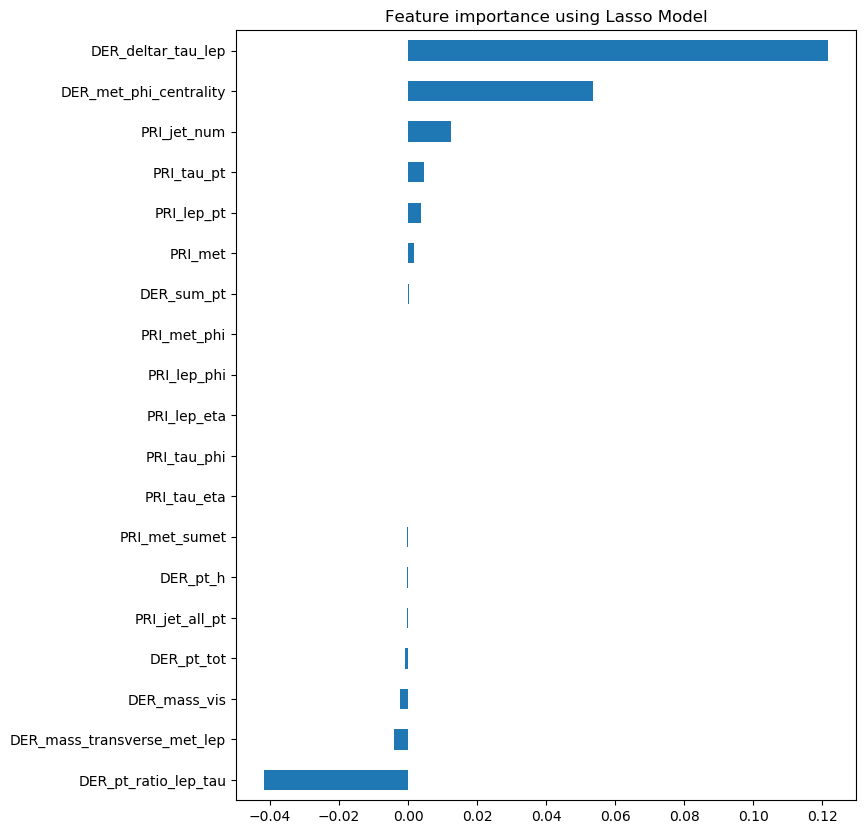

In [107]:
%matplotlib inline

sns.reset_orig()

imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (8.0, 10.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

plt.show()